In [1]:
import matplotlib.pyplot as plt
import geopandas as gpd
import numpy as np
from shapely.geometry import LineString
import random
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from scipy.stats import t
from matplotlib.lines import Line2D
import mapclassify as mc
from matplotlib.image import imread
from PIL import Image
import seaborn as sns
import math
import matplotlib.image as mpimg
import os
from libpysal.weights import KNN
from esda.getisord import G_Local
from statsmodels.stats.multitest import multipletests
import matplotlib.patches as mpatches

## Calculating the porosity index

### Load base data

In [2]:
final_edges = gpd.read_file('../base_data/final_edges.geojson')
stats = pd.read_csv('../inference/results_model_v6/results.csv')
images_dir = '../inference/results_model_v6/images'

In [3]:
len(final_edges)

1007

Ensure that all ids have the same format

In [4]:
for df in (final_edges, stats):
    df['edge_id'] = df['edge_id'].astype(str).str.zfill(7)

Check which edges don't have images

In [5]:
#Convert to sets to perform difference operations
edges_final = set(final_edges['edge_id'])
edges_stats = set(stats['edge_id'])

#Edges in edges_final but not in stats
only_in_final = list(edges_final - edges_stats)

print("Edges without images:", only_in_final)
percentage_not_in_stats = (len(only_in_final) / len(edges_final)) * 100

print(f"Percentage of edges without images: {percentage_not_in_stats:.2f}%")

Edges without images: ['0177003', '0190004', '0137004', '0067002', '0041001', '0209004', '0069001', '0140005', '0007002', '0202004', '0136002', '0225002', '0067003', '0045001', '0272003', '0140002', '0261001', '0137005', '0272001', '0206001', '0186003', '0283001', '0029003', '0114001', '0184003', '0144004', '0146002', '0007004', '0206004', '0003002', '0035003', '0003004', '0046003', '0007003', '0043002', '0101002', '0068003', '0063001', '0050001', '0251003', '0040001', '0227004', '0069003', '0133004', '0050002', '0208002', '0186002', '0139004', '0101003', '0069004', '0050003', '0140003', '0135001', '0003003', '0271001', '0140004', '0146001', '0207003']
Percentage of edges without images: 5.76%


Percentage of edges without data are really close with percentage of missing images when retrieving Mapillary images. So it's just the limitation of the coverage of Mapillary

### Filter only valid images

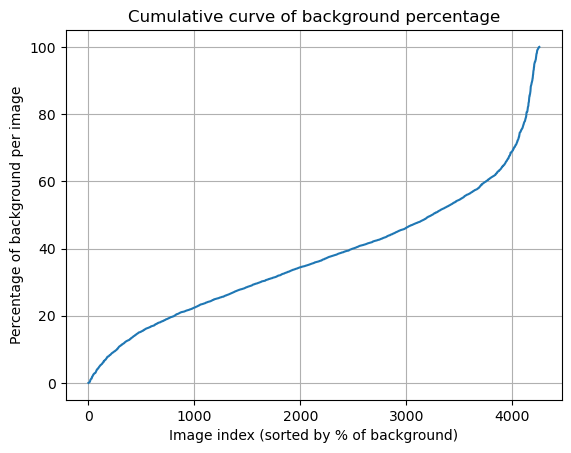

In [6]:
#Sort values of pct_background
sorted_background = stats['pct_background'].sort_values().reset_index(drop=True)

#Plot 
plt.plot(sorted_background)
plt.ylabel("Percentage of background per image")
plt.xlabel("Image index (sorted by % of background)")
plt.title("Cumulative curve of background percentage")
plt.grid()
plt.show()


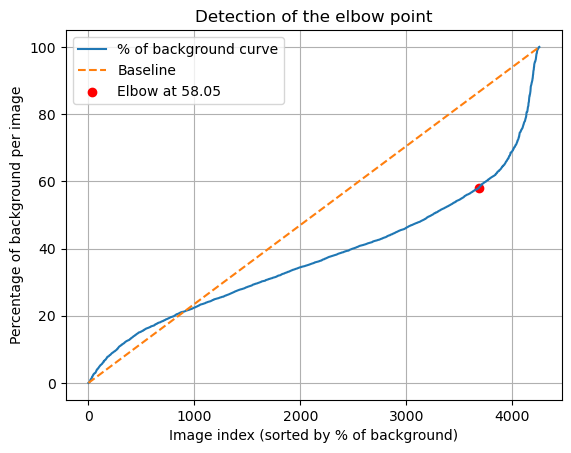

Suggested threshold for percentage of background per image 58.05


In [7]:
# Convert to numpy arrays
y_nb = sorted_background.values
x_nb = np.arange(len(y_nb))

#Line between first and last point
line_start_nb = np.array([x_nb[0], y_nb[0]])
line_end_nb = np.array([x_nb[-1], y_nb[-1]])

# Vector of the line
line_vec_nb = line_end_nb - line_start_nb
line_vec_norm_nb = line_vec_nb / np.linalg.norm(line_vec_nb)

# Vectors from start to each point
vecs_nb = np.vstack([x_nb, y_nb]).T - line_start_nb

# Orthogonal projection of each point onto the line
proj_nb = np.dot(vecs_nb, line_vec_norm_nb)
proj_point_nb = np.outer(proj_nb, line_vec_norm_nb) + line_start_nb

# Distances from each point to the line
distances_nb = np.linalg.norm(vecs_nb - proj_point_nb, axis=1)

# Index of the point of maximum distance (the "knee")
knee_idx = np.argmax(distances_nb)
knee_value = y_nb[knee_idx]

#Plot
plt.plot(x_nb, y_nb, label="% of background curve")
plt.plot([x_nb[0], x_nb[-1]], [y_nb[0], y_nb[-1]], '--', label="Baseline")
plt.scatter(knee_idx, knee_value, color="red", label=f"Elbow at {knee_value:.2f}")
plt.xlabel("Image index (sorted by % of background)")
plt.ylabel("Percentage of background per image")
plt.title("Detection of the elbow point")
plt.legend()
plt.grid()
plt.show()

print(f"Suggested threshold for percentage of background per image {knee_value:.2f}")

In [8]:
#Define fitness using this threshold
stats['fitness'] = stats['pct_background'] < knee_value
fitness_counts = stats['fitness'].value_counts(normalize=True) * 100
print(f"Percentage of Images fit for analysis: {fitness_counts[True]:.2f}%")
print(f"Percentage of Images not fit for analysis: {fitness_counts[False]:.2f}%")

Percentage of Images fit for analysis: 86.57%
Percentage of Images not fit for analysis: 13.43%


### Visualize examples of too much background

In [9]:


#List all files in the directory
image_files = [f for f in os.listdir(images_dir) if f.endswith('_overlay.png')]

#Extract edge_id and pano_id from filenames
image_data = []
for file in image_files:
    parts = file.split('_')
    if len(parts) >= 2:
        edge_id = parts[0]
        pano_id = int(parts[1])
        image_data.append({'filename': file, 'edge_id': edge_id, 'pano_id': pano_id})

#Create a DataFrame
images = pd.DataFrame(image_data)

In [10]:
images['edge_id'] = images['edge_id'].astype(str).str.zfill(7)

In [11]:
#Merge stats with images on pano_id and edge_id
stats = stats.merge(images[['pano_id', 'edge_id', 'filename']], on=['pano_id', 'edge_id'], how='left')

In [12]:
#Group by edge_id and check if all fitness values are False
edges_all_false = stats.groupby('edge_id')['fitness'].apply(lambda x: (x == False).all())

# Filter only the edge_id where this condition is True
edges_with_all_false = edges_all_false[edges_all_false].index.tolist()

total_edges = edges_all_false.shape[0]
num_edges_all_false = len(edges_with_all_false)
percentage_all_false = (num_edges_all_false / total_edges) * 100

print(len(edges_with_all_false), "edges with images with all fitness values as False")
print(f"That is {percentage_all_false:.2f}% of all edges with images.")
print(edges_with_all_false)


44 edges with images with all fitness values as False
That is 4.64% of all edges with images.
['0019004', '0035004', '0036001', '0051003', '0051004', '0057001', '0057002', '0057003', '0057004', '0057005', '0057006', '0059004', '0069002', '0089002', '0094003', '0099004', '0105004', '0125003', '0131005', '0131007', '0135004', '0137003', '0148002', '0169002', '0170001', '0170002', '0170003', '0170004', '0171002', '0177001', '0190003', '0222003', '0223005', '0231004', '0235004', '0255002', '0259001', '0259002', '0259003', '0259004', '0281001', '0281002', '0281003', '0281004']


After a quick overview we see that this was super good, as it filtered those images corresponding to parks mainly or where images are wrongly oriented because camera was turning or if too much noise is present to be able to define assess the image

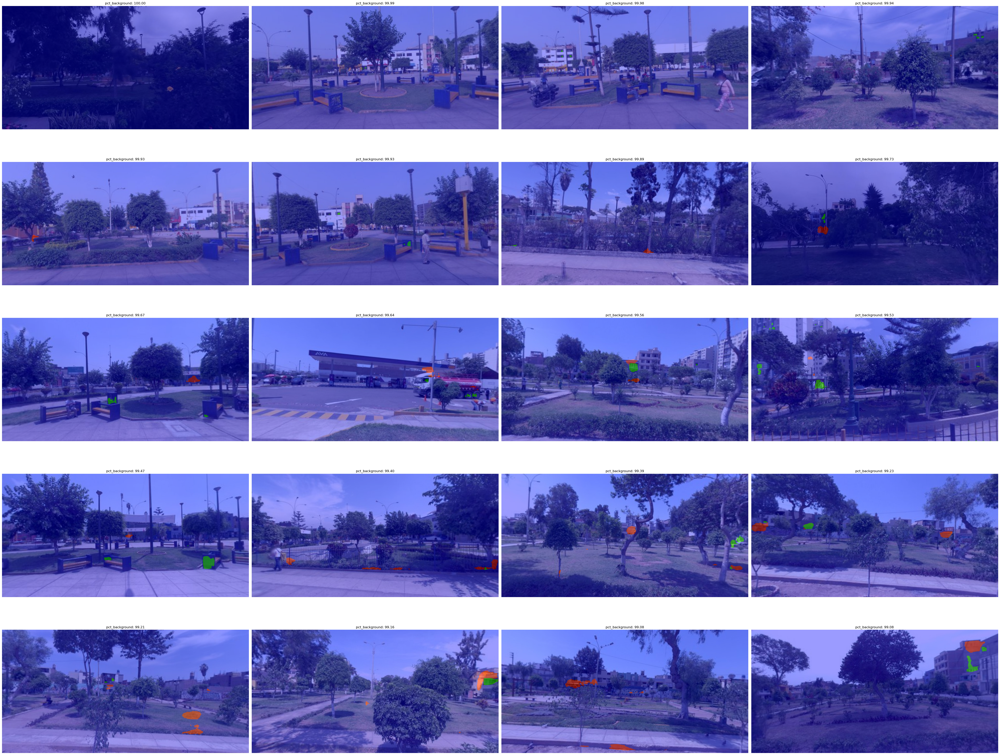

In [13]:
#Filter rows where fitness is False and sort by pct_background
filtered_stats = stats[stats['fitness'] == False].sort_values(by='pct_background', ascending=False).head(25)

#Plot images
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(50, 40))
axes = axes.flatten()

for ax, (_, row) in zip(axes, filtered_stats.iterrows()):
    img_path = os.path.join(images_dir, row['filename'])
    img = imread(img_path)
    ax.imshow(img)
    ax.set_title(f"pct_background: {row['pct_background']:.2f}")
    ax.axis('off')

for ax in axes[len(filtered_stats):]:
    ax.axis('off')

plt.tight_layout()
plt.show()

### Image-level porosity

In [14]:
stats_fitness_true = stats[stats["fitness"] == True].copy()
stats_fitness_true['porosity_index'] = stats_fitness_true['pct_porosity'] / (stats_fitness_true['pct_porosity'] + stats_fitness_true['pct_wall'])

In [15]:
stats_fitness_true.head()

,edge_id,pano_id,pct_background,pct_porosity,pct_wall,fitness,filename,porosity_index
1,0010001,1215914755546293,26.9226,11.1980,61.8793,True,10001_1215914755546293_overlay.png,0.153235
2,0010001,184794883509936,40.0375,4.1283,55.8342,True,10001_184794883509936_overlay.png,0.068848
6,0010001,2950758351849955,35.9543,3.6829,60.3628,True,10001_2950758351849955_overlay.png,0.057504
7,0010001,297660028507866,55.8142,6.3227,37.8632,True,10001_297660028507866_overlay.png,0.143093
9,0010001,3798441343598511,35.5484,13.0310,51.4206,True,10001_3798441343598511_overlay.png,0.202183


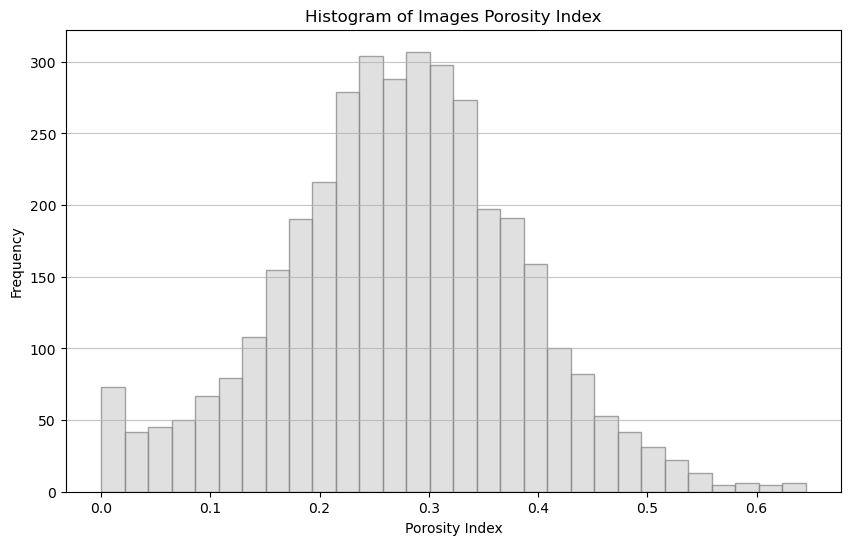

In [16]:
# Plot histogram of images porosity_index
plt.figure(figsize=(10, 6))
plt.hist(stats_fitness_true['porosity_index'], bins=30, color='lightgrey', edgecolor='grey', alpha=0.7)
plt.xlabel('Porosity Index')
plt.ylabel('Frequency')
plt.title('Histogram of Images Porosity Index')
plt.grid(axis='y', alpha=0.75)
plt.show()

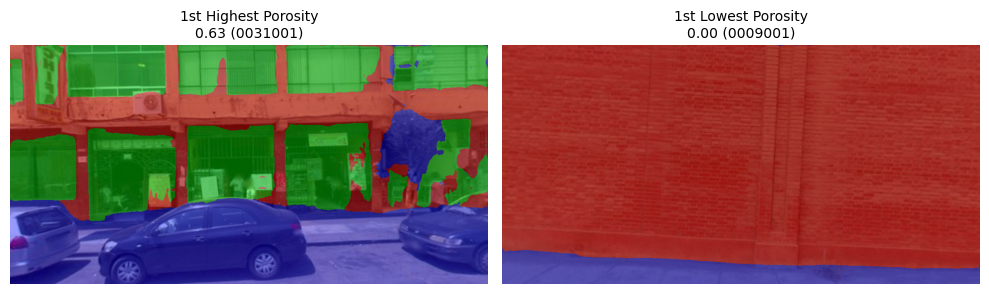

In [17]:



def get_ranked_image(df, rank=1, highest=True):
    """
    Get the image at a given rank by porosity_index.
    rank = 1 → highest or lowest depending on highest=True
    highest=True → sort descending (top porosity)
    highest=False → sort ascending (lowest porosity)
    """
    sorted_df = df.sort_values('porosity_index', ascending=not highest).reset_index(drop=True)
    return sorted_df.iloc[rank-1]  # rank-1 because iloc is zero-based

def show_image(filename, title):
    img_path = os.path.join(images_dir, filename)
    img = Image.open(img_path)
    plt.imshow(img)
    plt.title(title, fontsize=10)
    plt.axis("off")

# Example usage
# 3rd highest porosity
row_high = get_ranked_image(stats_fitness_true, rank=3, highest=True)
# 1st lowest porosity
row_low  = get_ranked_image(stats_fitness_true, rank=1, highest=False)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
show_image(row_high['filename'], f"{1}st Highest Porosity\n{row_high['porosity_index']:.2f} ({row_high['edge_id']})")

plt.subplot(1, 2, 2)
show_image(row_low['filename'], f"{1}st Lowest Porosity\n{row_low['porosity_index']:.2f} ({row_low['edge_id']})")

plt.tight_layout()
plt.show()

## Aggregate by edge

In [18]:
agg = (stats_fitness_true.groupby('edge_id')['porosity_index'].agg(n='count', mean='mean', median='median', std='std'))
agg['se'] = agg['std'] / np.sqrt(agg['n'].clip(lower=1))
agg['tcrit'] = t.ppf(0.975, np.maximum(agg['n']-1, 1))
agg['ci95_low']  = agg['mean'] - agg['tcrit']*agg['se']
agg['ci95_high'] = agg['mean'] + agg['tcrit']*agg['se']
agg = agg.reset_index()

final_edges = final_edges.merge(agg, on='edge_id', how='left')

I will use median as the 'porosity index' as it's more robust to less values and higher std

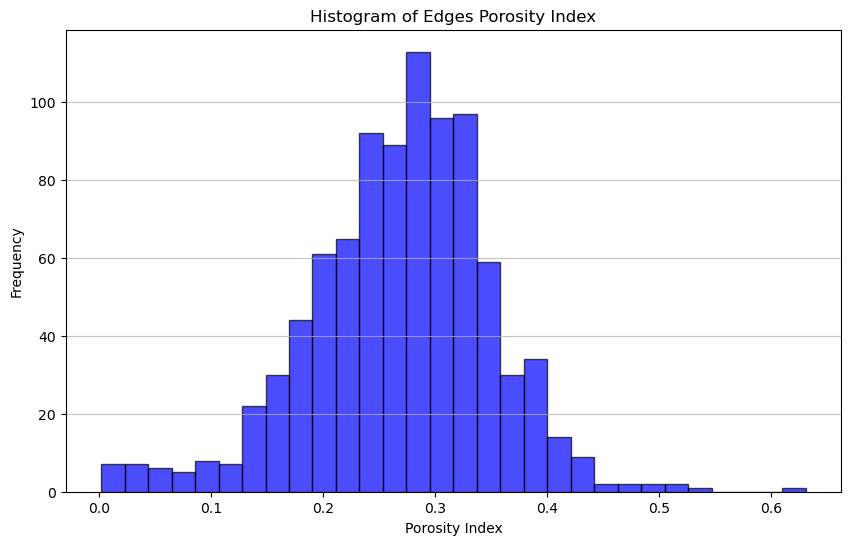

In [19]:
# Plot histogram of median edge porosity_index
plt.figure(figsize=(10, 6))
plt.hist(final_edges['median'], bins=30, color='blue', edgecolor='black', alpha=0.7)
plt.xlabel('Porosity Index')
plt.ylabel('Frequency')
plt.title('Histogram of Edges Porosity Index')
plt.grid(axis='y', alpha=0.75)
plt.show()

### Prepare base map

In [20]:
#Offset blocks to have space for thick edges maps
cent = final_edges.dissolve('block_id', as_index=False).set_index('block_id').centroid
offset = 1

def offset_to_interior(row, d=offset):
    line = row.geometry
    left  = line.parallel_offset(d, 'left', join_style=2)
    right = line.parallel_offset(d, 'right', join_style=2)
    c = cent.loc[row['block_id']]
    if left.distance(c) < right.distance(c):
        return left
    return right

final_edges['offset_geometry'] = final_edges.apply(offset_to_interior, axis=1)
final_edges = final_edges.set_geometry('offset_geometry')

In [21]:
final_edges.set_geometry('offset_geometry', inplace=True)

### Add porosity index to edges

In [22]:
final_edges.head()

,block_id,length,edge_id,geometry,n,mean,median,std,se,tcrit,ci95_low,ci95_high,offset_geometry
0,3,36.009094,0003001,"LINESTRING (277732.184 8666014.061, 277707.19 ...",1.0,0.389587,0.389587,NaN,NaN,12.706205,NaN,NaN,"LINESTRING (277731.465 8666014.755, 277706.47 ..."
1,3,67.211507,0003002,"LINESTRING (277707.19 8665988.14, 277641.698 8...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (277707.414 8665989.114, 277641.923..."
2,3,124.091153,0003003,"LINESTRING (277641.698 8666003.249, 277684.263...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (277642.638 8666002.906, 277685.202..."
3,3,44.244162,0003004,"LINESTRING (277684.263 8666119.812, 277728.342...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (277684.349 8666118.815, 277728.428..."
4,3,109.638713,0003005,"LINESTRING (277728.342 8666123.632, 277732.184...",5.0,0.283642,0.319102,0.100489,0.04494,2.776445,0.158868,0.408415,"LINESTRING (277727.342 8666123.597, 277731.185..."


### Classify edge-level porosity indices in classes

In [23]:
#Get only valid edges
col = "median" 
df = final_edges

df_valid = df[df[col].notna()].copy()
df_nan = df[df[col].isna()].copy()
values = df_valid[col].values

In [24]:
#Calculate GVF
def calculate_gvf(data, bins):
    mean_all = np.mean(data)
    sst = np.sum((data - mean_all) ** 2)
    ssw = 0
    lower_bound = -np.inf
    for upper_bound in bins:
        group = data[(data > lower_bound) & (data <= upper_bound)]
        if len(group) > 0:
            mean_group = np.mean(group)
            ssw += np.sum((group - mean_group) ** 2)
        lower_bound = upper_bound
    return (sst - ssw) / sst

#Find best k for porosity classes
k_range = range(3, 9)
results = []
for k in k_range:
    nb = mc.NaturalBreaks(values, k=k)
    score = calculate_gvf(values, nb.bins)
    results.append(score)

#Knee point detection
x = np.array(list(k_range))
y = np.array(results)

x_norm = (x - x.min()) / (x.max() - x.min())
y_norm = (y - y.min()) / (y.max() - y.min())

#Line between first and last points
line_vec = np.array([x_norm[-1] - x_norm[0], y_norm[-1] - y_norm[0]])
line_vec_norm = line_vec / np.sqrt(np.sum(line_vec**2))

#Calculate distance from each point to the line
vec_from_first = np.column_stack((x_norm - x_norm[0], y_norm - y_norm[0]))
scalar_proj = np.sum(vec_from_first * line_vec_norm, axis=1)
proj = np.outer(scalar_proj, line_vec_norm)
dist_to_line = np.sqrt(np.sum((vec_from_first - proj)**2, axis=1))

#Find knee point
best_k = x[np.argmax(dist_to_line)]

print("\nGVF for each number of classes")
for k, score in zip(k_range, results):
    print(f"k={k}: GVF={score:.4f}")
print(f"\nRecommended number of classes: {best_k}")

#Add final classification
nb_final = mc.NaturalBreaks(values, k=best_k)
df_valid["porosity_class"] = nb_final.find_bin(values)



c:\Users\FIORELLA\anaconda3\envs\porosity_env_\lib\site-packages\sklearn\cluster\_kmeans.py:1419: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(
c:\Users\FIORELLA\anaconda3\envs\porosity_env_\lib\site-packages\sklearn\cluster\_kmeans.py:1419: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(
c:\Users\FIORELLA\anaconda3\envs\porosity_env_\lib\site-packages\sklearn\cluster\_kmeans.py:1419: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(
c:\Users\FIORELLA\anaconda3\envs\porosity_env_\lib\site-packages\sklea


GVF for each number of classes
k=3: GVF=0.7692
k=4: GVF=0.8532
k=5: GVF=0.9055
k=6: GVF=0.9318
k=7: GVF=0.9489
k=8: GVF=0.9629

Recommended number of classes: 5


c:\Users\FIORELLA\anaconda3\envs\porosity_env_\lib\site-packages\sklearn\cluster\_kmeans.py:1419: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(


### Graph knee analysis

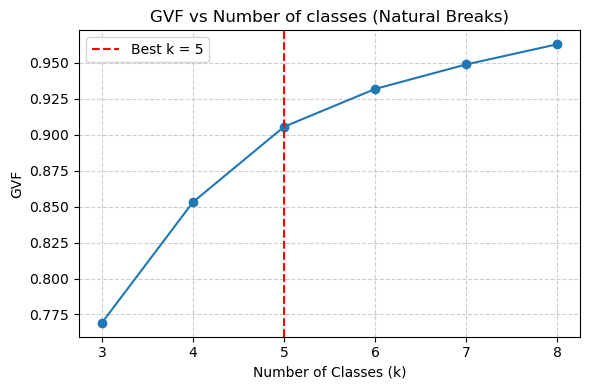

In [25]:
label_map = {
    3: ["Low", "Medium", "High"],
    4: ["Low", "Medium-Low", "Medium-High", "High"],
    5: ["Very Low", "Low", "Medium", "High", "Very High"],
    6: ["Very Low", "Low", "Medium-Low", "Medium-High", "High", "Very High"],
    7: ["Very Low", "Low", "Medium-Low", "Medium", "Medium-High", "High", "Very High"],
    8: ["Extremely Low", "Very Low", "Low", "Medium-Low", "Medium-High", "High", "Very High", "Extremely High"]
}
df_valid["porosity_label"] = df_valid["porosity_class"].map(lambda x: label_map[best_k][x])

# === Graficar GVF y el codo ===
plt.figure(figsize=(6, 4))
plt.plot(x, y, marker="o")
plt.axvline(best_k, color="red", linestyle="--", label=f"Best k = {best_k}")
plt.title("GVF vs Number of classes (Natural Breaks)")
plt.xlabel("Number of Classes (k)")
plt.ylabel("GVF")
plt.grid(True, linestyle="--", alpha=0.6)
plt.legend()
plt.tight_layout()
plt.show()

In [26]:
#Add no data class
df_nan["porosity_class"] = np.nan
df_nan["porosity_label"] = "No data"

#Concatenate valid and NaN dataframes
df_final = pd.concat([df_valid, df_nan], ignore_index=True)

In [27]:
print("\nCount by class:")
print(df_final["porosity_label"].value_counts())


Count by class:
porosity_label
High         309
Medium       291
Low          177
No data      102
Very High     92
Very Low      36
Name: count, dtype: int64


In [28]:
total = len(df_final)
no_data_count = (df_final['porosity_label'] == "No data").sum()
percentage_no_data = (no_data_count / total) * 100

print(f"Percentage of edges with 'No data': {percentage_no_data:.2f}%")


Percentage of edges with 'No data': 10.13%


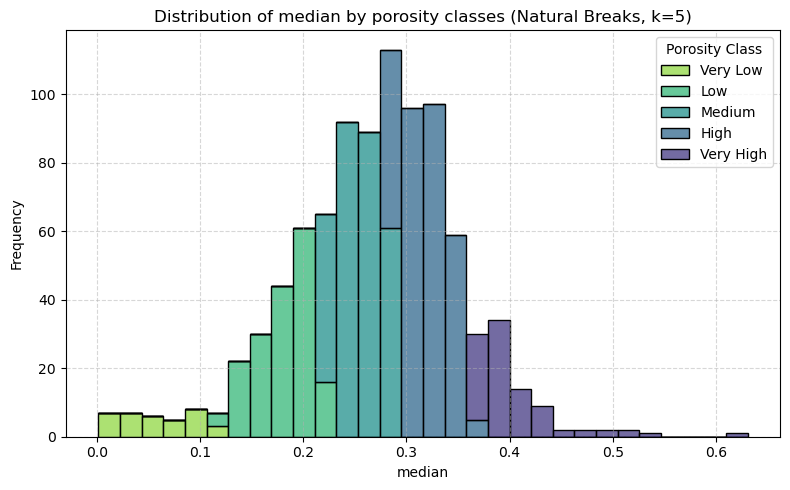

In [51]:
# Histogram per class with classes in the legend


plt.figure(figsize=(8, 5))
sns.histplot(
    data=df_valid,
    x=col,
    hue="porosity_label",
    palette="viridis",
    bins=30,
    multiple="stack",
    edgecolor="black",
    hue_order=label_map[best_k][::-1]  # Reverse the order of classes
)

plt.title(f"Distribution of {col} by porosity classes (Natural Breaks, k={best_k})")
plt.xlabel(col)
plt.ylabel("Frequency")
plt.legend(title="Porosity Class", labels=label_map[best_k], loc="upper right") 
plt.grid(True, linestyle="--", alpha=0.5)
plt.tight_layout()
plt.show()

In [30]:
#Load the GeoJSON file
breña_blocks = gpd.read_file("../base_data/breña_blocks_proj.geojson")

#Display the first few rows
print(breña_blocks.head())

        area_m2  n_vertices  block_id  \
0   8802.147998           6         3   
1   7021.267305           6         7   
2  37387.664744           8         9   
3  27277.698624           5        10   
4  28014.038309           5        12   

                                            geometry  
0  POLYGON ((277732.184 8666014.061, 277707.19 86...  
1  POLYGON ((277712.203 8665919.637, 277672.64 86...  
2  POLYGON ((276418.659 8666886.133, 276549.493 8...  
3  POLYGON ((276539.17 8667153.788, 276409.671 86...  
4  POLYGON ((276863.29 8667097.378, 277118.42 866...  


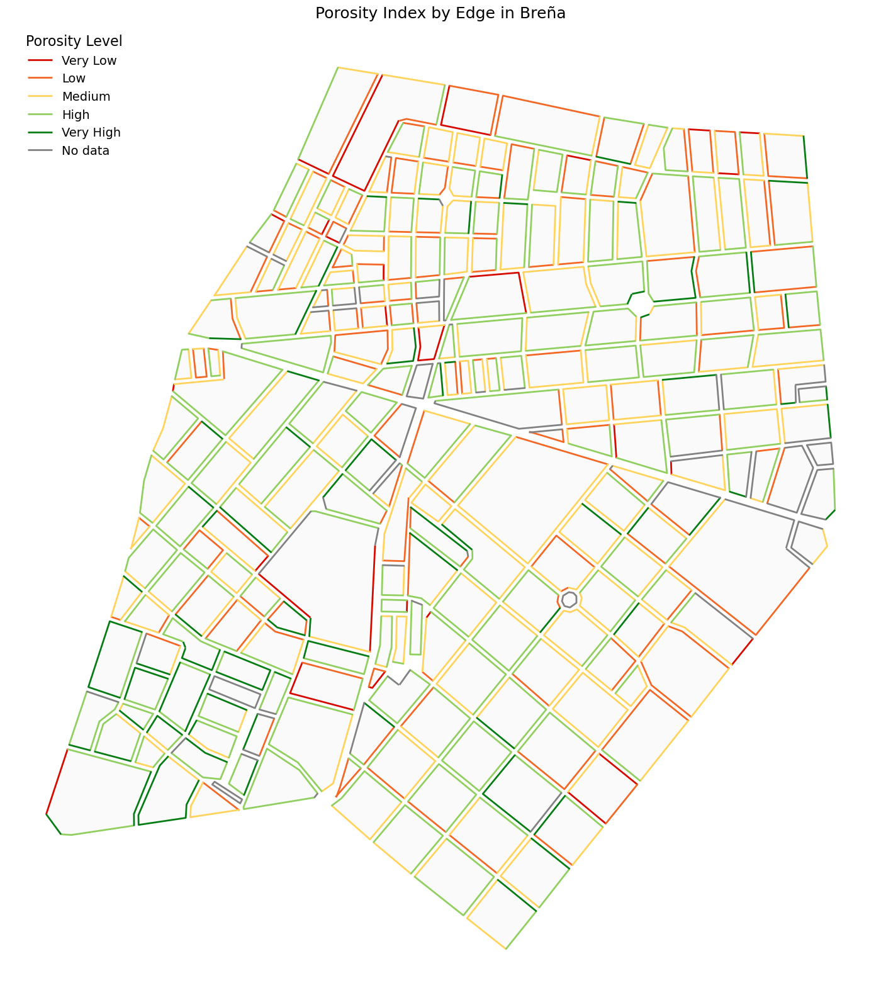

In [31]:
#Read district boundary
district = gpd.read_file("../base_data/breña_wgs.geojson")

#Ensure ordered categories and colors
cat_order = ["Very Low", "Low", "Medium", "High", "Very High", "No data"]
df_final["porosity_label"] = pd.Categorical(df_final["porosity_label"],
                                            categories=cat_order, ordered=True)
colors = {
    "Very Low":  "#d60b00",
    "Low":       "#f36827",
    "Medium":    "#ffd35c",
    "High":      "#91cf60",
    "Very High": "#067d14",
    "No data":   "#828282"
}

fig, ax = plt.subplots(figsize=(20, 16))

#Plot breña_blocks as a soft base
breña_blocks.plot(ax=ax, facecolor="#f2f2f250", edgecolor="none")

#Plot edges by class (slightly thicker for higher porosity)
width_map = {"Very Low":2, "Low":2, "Medium":2.0, "High":2.0, "Very High":2.0, "No data":2}
for cat in cat_order:
    subset = df_final[df_final["porosity_label"] == cat]
    subset.plot(ax=ax, color=colors[cat], linewidth=width_map[cat], label=cat)

ax.set_axis_off()
ax.set_title("Porosity Index by Edge in Breña", fontsize=18)
ax.legend(title="Porosity Level", loc="upper left", bbox_to_anchor=(0.01, 1), frameon=False, fontsize=14, title_fontsize=16)
plt.tight_layout()
plt.show()

### Analyse density of valid images per edge

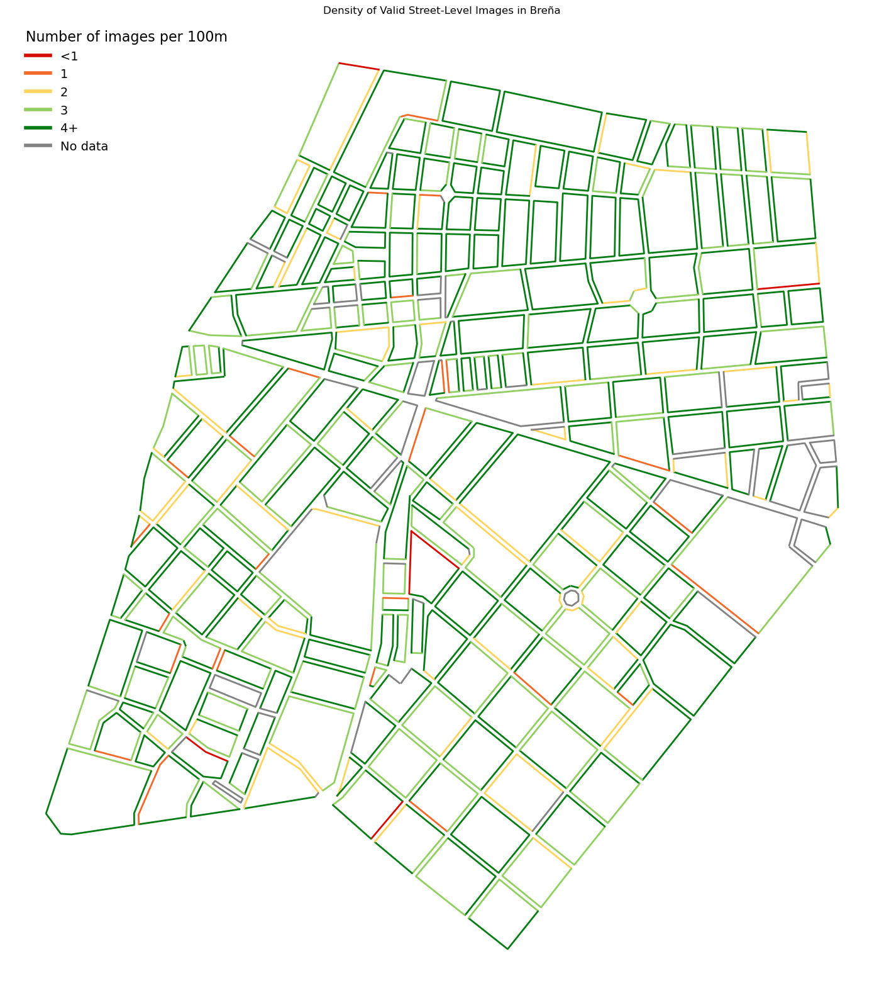

In [32]:
#Calculate density
df_valid_density = df_valid.copy()
df_valid_density["density_per_100m"] = df_valid_density["n"] / (df_valid_density["length"] / 100.0)

#Classify density
def classify_density_fixed(val):
    if pd.isna(val):
        return "No data"
    elif val < 1:
        return "<1"
    elif val < 2:
        return "1"
    elif val < 3:
        return "2"
    elif val < 4:
        return "3"
    else:
        return "4+"

df_valid_density["density_bucket"] = df_valid_density["density_per_100m"].apply(classify_density_fixed)

#Colours
density_colors = {
    "<1":    "#d60b00",  # red
    "1":     "#f36827",  # orange
    "2":     "#ffd35c",  # yellow
    "3":     "#91cf60",  # light green
    "4+":    "#067d14",  # dark green
    "No data": "#828282"
}

#Merge to df_map
df_map = df_final.drop(columns=["density_per_100m","density_bucket"], errors="ignore")
df_map = df_map.merge(
    df_valid_density[["edge_id","density_per_100m","density_bucket"]],
    on="edge_id", how="left"
)

df_map["density_color"] = df_map["density_bucket"].map(density_colors).fillna(density_colors["No data"])

#Plot
fig, ax = plt.subplots(figsize=(20, 16))
df_map.plot(ax=ax, color=df_map["density_color"], linewidth=2)
ax.set_axis_off()
plt.title("Density of Valid Street-Level Images in Breña")

handles = [
    Line2D([0],[0], color=density_colors[l], lw=4, label=l)
    for l in ["<1","1","2","3","4+","No data"]
]
ax.legend(handles=handles, title="Number of images per 100m", loc="upper left", bbox_to_anchor=(0.01, 1), frameon=False, fontsize=14, title_fontsize=16, alignment="left")
plt.tight_layout()
plt.show()

In [33]:
#Count
count = df_map["density_bucket"].value_counts(dropna=False)

# Percentage
percentage = df_map["density_bucket"].value_counts(normalize=True, dropna=False) * 100

# Combine into a single DataFrame and reorder categories
order_categories = ["<1", "1", "2", "3", "4+", "No data"]
summary = pd.DataFrame({
    "count": count,
    "percent": percentage.round(2)
}).reindex(order_categories)

print(summary)


                count  percent
density_bucket                
<1                6.0     0.60
1                26.0     2.58
2                78.0     7.75
3               252.0    25.02
4+              543.0    53.92
No data           NaN      NaN


### Variability analysis

c:\Users\FIORELLA\anaconda3\envs\porosity_env_\lib\site-packages\sklearn\cluster\_kmeans.py:1419: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(


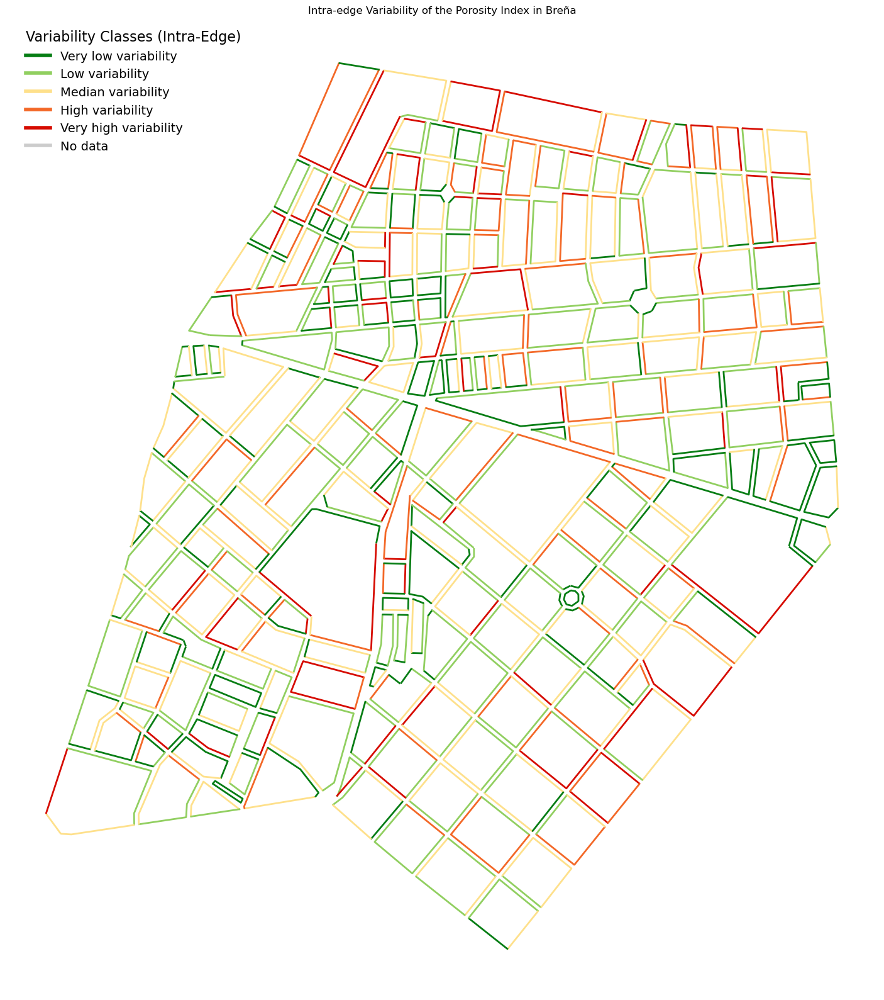


Variability summary:
                        edges  percent
cv_category                          
Low variability          286    28.40
Very low variability     259    25.72
Median variability       242    24.03
High variability         129    12.81
Very high variability     91     9.04
No data                    0     0.00


In [34]:
#Compute relative variability

EPS = 1e-9
Q_LOW, Q_HIGH = 0.05, 0.95
MEDIAN_MIN = 0.05  # Avoid division by 0

#Compute Coefficient of Variation (CV) from df_final
df_var = df_final.copy()
df_var["std"] = df_var["std"].replace(0, np.nan).fillna(EPS)
median_abs = df_var["median"].abs().replace(0, np.nan)
median_abs = median_abs.where(median_abs >= MEDIAN_MIN, MEDIAN_MIN)
df_var["cv_real"] = df_var["std"] / (median_abs + EPS)

def classify_cv_jenks(series, q_low=Q_LOW, q_high=Q_HIGH, k=5):
    """
    Classify CV into k classes using Jenks (fallback to quantiles) on valid values only.
    Edges without data keep a 'No data' label instead of being assigned to a class.
    """
    labels5 = ["Very low variability","Low variability","Median variability","High variability","Very high variability"]
    all_labels = labels5 + ["No data"]

    # mask of valid CV values
    mask = series.notna()
    out = pd.Series(index=series.index, dtype=object)

    if mask.sum() == 0:
        # nothing to classify; return all 'No data'
        out[:] = "No data"
        return pd.Categorical(out, categories=all_labels, ordered=True), np.array([]), all_labels

    s = series[mask]

    # clip only among valid values
    low, high = s.quantile([q_low, q_high])
    s_clip = s.clip(lower=low, upper=high)

    prefer_jenks = len(np.unique(s_clip)) >= k
    try:
        clf = mc.NaturalBreaks(s_clip, k=k) if prefer_jenks else mc.Quantiles(s_clip, k=k)
    except Exception:
        clf = mc.Quantiles(s_clip, k=k)

    bins = clf.bins  # upper bounds
    classes_valid = np.digitize(s, bins, right=True)
    classes_valid = np.clip(classes_valid, 0, k-1)  # 0..k-1

    # assign class labels to valid values and 'No data' to the rest
    out.loc[mask] = [labels5[c] for c in classes_valid]
    out.loc[~mask] = "No data"

    cat = pd.Categorical(out, categories=all_labels, ordered=True)
    return cat, bins, all_labels

df_var["variability_label5"], bins_var, labels_var = classify_cv_jenks(df_var["cv_real"], k=5)

#Merge back into df_map
df_map = df_map.drop(columns=["cv_real","variability_label5"], errors="ignore")
df_map = df_map.merge(df_var[["edge_id","cv_real","variability_label5"]], on="edge_id", how="left")

#Colors and plot
var_colors = {
    "Very low variability": "#067d14",
    "Low variability":         "#91cf60",
    "Median variability":             "#fee08b",
    "High variability":         "#f36827",
    "Very high variability": "#d60b00",
    "No data":           "#cccccc",
}
labels_obj_var = df_map["variability_label5"].astype(object)
df_map["var_cat_color"] = labels_obj_var.map(var_colors).fillna(var_colors["No data"])

fig, ax = plt.subplots(figsize=(20, 16))
df_map.plot(ax=ax, color=df_map["var_cat_color"], linewidth=2)
ax.set_axis_off()
plt.title("Intra-edge Variability of the Porosity Index in Breña")

handles = [
    Line2D([0],[0], color=var_colors[l], lw=4, label=l)
    for l in ["Very low variability","Low variability","Median variability","High variability","Very high variability","No data"]
]
ax.legend(handles=handles, title="Variability Classes (Intra-Edge)", loc="upper left", bbox_to_anchor=(0.01, 1), frameon=False, fontsize=14, title_fontsize=16, alignment="left")
plt.tight_layout()
plt.show()

#Summary
res_var = (df_map["variability_label5"]
           .value_counts(dropna=False)
           .rename_axis("cv_category")
           .to_frame("edges"))
res_var["percent"] = (res_var["edges"]/len(df_map)*100).round(2)
print("\nVariability summary:\n", res_var)

C:\Users\FIORELLA\AppData\Local\Temp\ipykernel_11864\1736976217.py:17: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(title="Variability", loc="upper right")


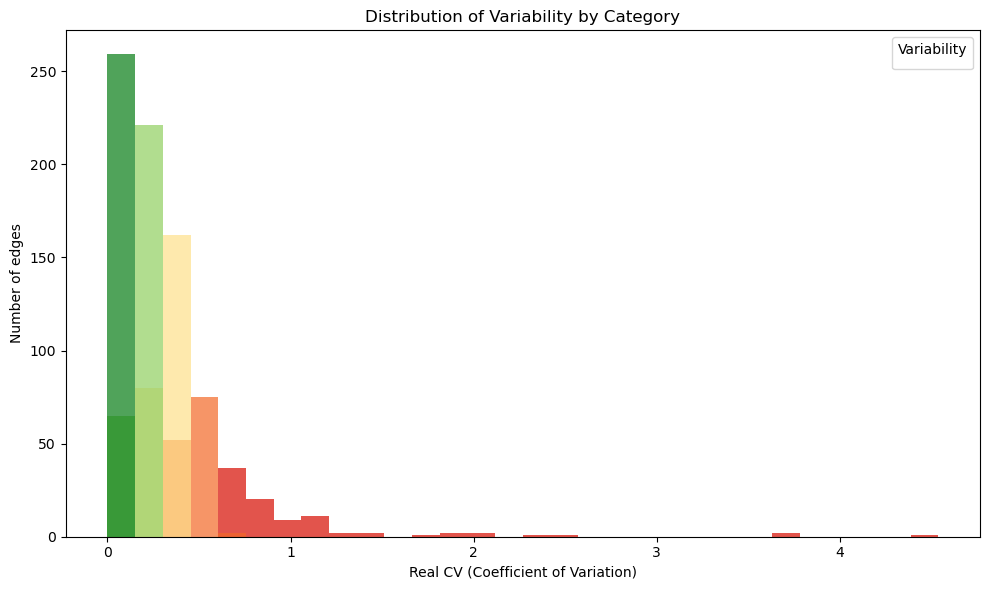

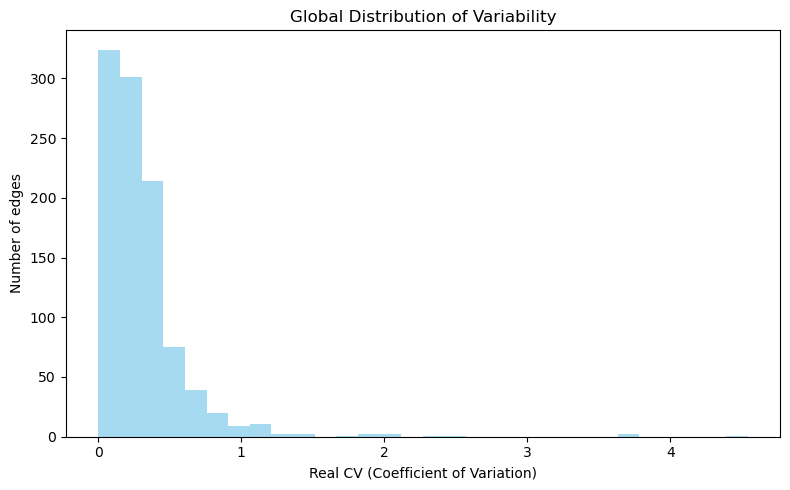

In [35]:
#Histograms of variability

#Histogram 1: distribution by category (variability)
plt.figure(figsize=(10, 6))
sns.histplot(
    data=df_map[df_map["variability_label5"].notna()],
    x="cv_real",
    hue="variability_label5",
    palette=var_colors,
    bins=30,
    edgecolor="none",
    alpha=0.7
)
plt.xlabel("Real CV (Coefficient of Variation)")
plt.ylabel("Number of edges")
plt.title("Distribution of Variability by Category")
plt.legend(title="Variability", loc="upper right")
plt.tight_layout()
plt.show()

#Histogram 2: global distribution of real CV
plt.figure(figsize=(8, 5))
sns.histplot(
    df_map["cv_real"].dropna(),
    bins=30,
    color="skyblue",
    edgecolor="none"
)
plt.xlabel("Real CV (Coefficient of Variation)")
plt.ylabel("Number of edges")
plt.title("Global Distribution of Variability")
plt.tight_layout()
plt.show()

### Filter outliers

In [36]:
# CV outliers (p99) with the new pipeline

MIN_N = 3  # ignore edges with less than MIN_N valid images
Q = 0.99  # percentile for outlier threshold

mask_valid = df_map["cv_real"].notna() & df_map["n"].ge(MIN_N)
outlier_threshold = df_map.loc[mask_valid, "cv_real"].quantile(Q)

outliers_cv = df_map.loc[mask_valid & (df_map["cv_real"] >= outlier_threshold)].copy()

print(f"Threshold (p{int(Q*100)}) Real CV: {outlier_threshold:.4f}")
print(f"Total outliers (n≥{MIN_N}): {len(outliers_cv)}\n")

cols_to_show = [
    "edge_id", "n", "median", "std", "cv_real", "length",
    "density_per_100m", "density_bucket",  # new density fields
    "porosity_class", "porosity_label"     # if already present in df_map
]

cols_present = [c for c in cols_to_show if c in outliers_cv.columns]
print(outliers_cv[cols_present].sort_values("cv_real", ascending=False).head(20))


Threshold (p99) Real CV: 1.9510
Total outliers (n≥3): 7

     edge_id     n    median       std   cv_real      length  \
438  0155004   5.0  0.043389  0.226970  4.539396  109.619233   
529  0180001   3.0  0.026777  0.188378  3.767568   65.520712   
437  0155003   5.0  0.049894  0.184270  3.685402  130.813019   
827  0269002   3.0  0.023317  0.124637  2.492736   88.059042   
353  0131001  10.0  0.030786  0.118550  2.370998  279.728481   
84   0039003   6.0  0.036929  0.103688  2.073757  130.542677   
4    0009001  13.0  0.046160  0.099266  1.985322  296.419006   

     density_per_100m density_bucket  porosity_class porosity_label  
438          4.561243             4+             0.0       Very Low  
529          4.578705             4+             0.0       Very Low  
437          3.822250              3             0.0       Very Low  
827          3.406805              3             0.0       Very Low  
353          3.574895              3             0.0       Very Low  
84        

In [37]:
images.head()

,filename,edge_id,pano_id
0,10001_1174611386312558_overlay.png,0010001,1174611386312558
1,10001_1215914755546293_overlay.png,0010001,1215914755546293
2,10001_184794883509936_overlay.png,0010001,184794883509936
3,10001_189640849677876_overlay.png,0010001,189640849677876
4,10001_196534445535671_overlay.png,0010001,196534445535671


### Visualize top variability edges

edge_id  cv_real   median      std    n     length
0155004 4.539396 0.043389 0.226970  5.0 109.619233
0180001 3.767568 0.026777 0.188378  3.0  65.520712
0155003 3.685402 0.049894 0.184270  5.0 130.813019
0269002 2.492736 0.023317 0.124637  3.0  88.059042
0131001 2.370998 0.030786 0.118550 10.0 279.728481

=== Edge 0155004 | CV_real=4.539 | median=0.043 | std=0.227 | n=5 ===


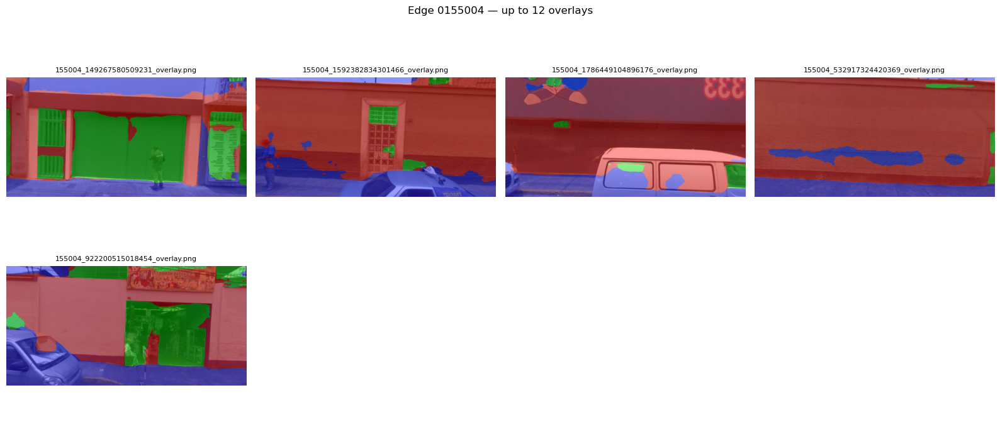


=== Edge 0180001 | CV_real=3.768 | median=0.027 | std=0.188 | n=3 ===


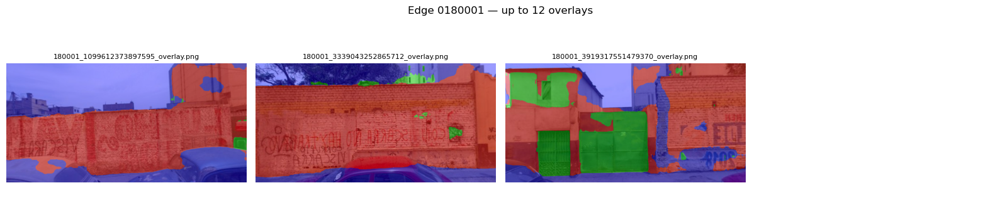


=== Edge 0155003 | CV_real=3.685 | median=0.050 | std=0.184 | n=5 ===


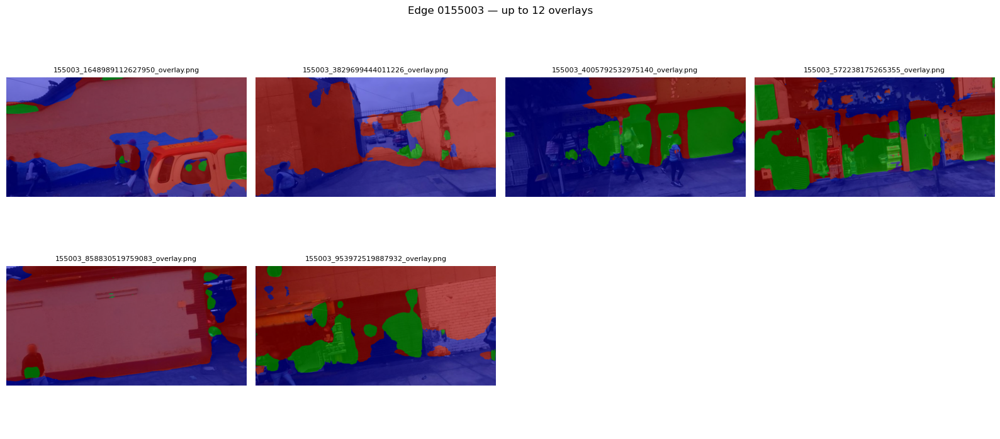


=== Edge 0269002 | CV_real=2.493 | median=0.023 | std=0.125 | n=3 ===


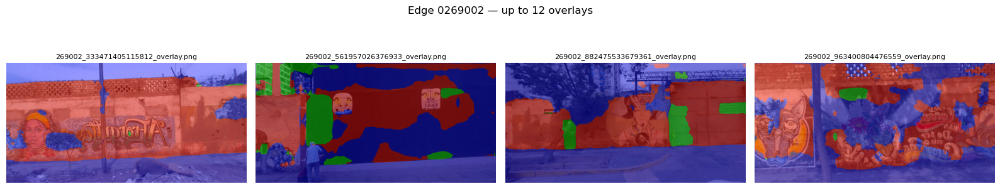


=== Edge 0131001 | CV_real=2.371 | median=0.031 | std=0.119 | n=10 ===


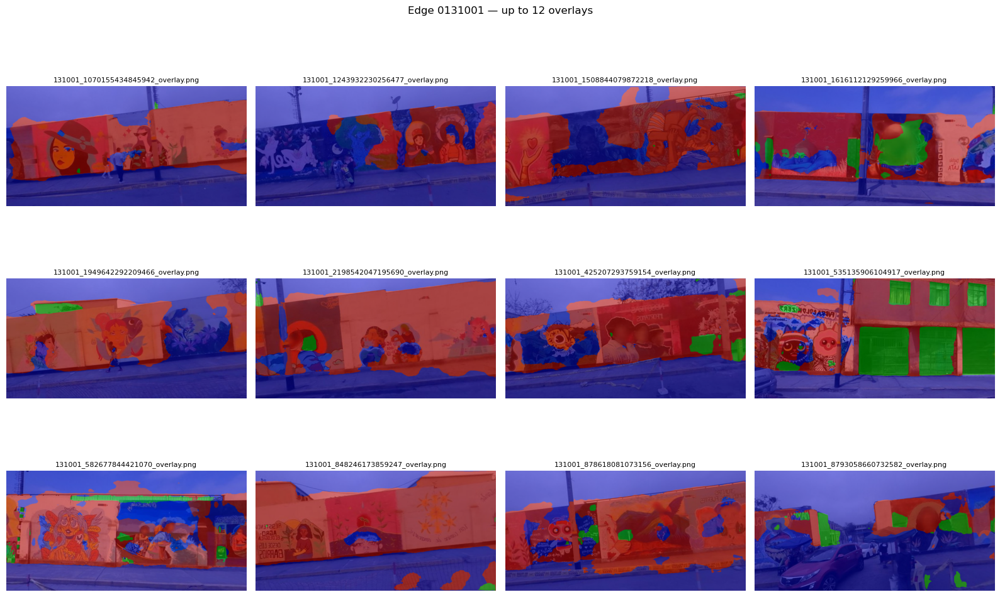

In [38]:
#Config
MIN_N = 3                 # minimum valid images per edge
TOP_K = 5                 # how many top variable edges to visualize
MAX_IMGS_PER_EDGE = 12    # maximum images per edge to show
BASE_DIR = images_dir if 'images_dir' in globals() else "../inference/results_model_v6/images"

#Select top K edges by variability (filtering minimum n)
mask_valid = df_map["cv_real"].notna() & df_map["n"].ge(MIN_N)
top_var_edges = (
    df_map.loc[mask_valid, ["edge_id","cv_real","median","std","n","length"]]
         .drop_duplicates("edge_id")
         .sort_values("cv_real", ascending=False)
         .head(TOP_K)
)

print(top_var_edges.to_string(index=False))

#Function to show images of an edge in a grid
def show_edge_images(edge_id, images_df, base_dir=BASE_DIR, max_imgs=MAX_IMGS_PER_EDGE):
    files = images_df.loc[images_df["edge_id"] == edge_id, "filename"].astype(str).tolist()
    if not files:
        print(f"[{edge_id}] No images found.")
        return

    files = files[:max_imgs]
    cols = 4
    rows = math.ceil(len(files) / cols)
    fig, axes = plt.subplots(rows, cols, figsize=(4*cols, 3.5*rows))
    axes = axes.flatten() if rows*cols > 1 else [axes]

    missing = 0
    for ax, fname in zip(axes, files):
        path = fname if os.path.isabs(fname) else os.path.join(base_dir, fname)
        if not os.path.isfile(path):
            missing += 1
            ax.axis("off")
            ax.set_title(f"(Missing)\n{os.path.basename(fname)}", fontsize=8)
            continue
        try:
            img = mpimg.imread(path)
            ax.imshow(img)
            ax.set_title(os.path.basename(fname), fontsize=8)
            ax.axis("off")
        except Exception as e:
            missing += 1
            ax.axis("off")
            ax.set_title(f"(Error)\n{os.path.basename(fname)}", fontsize=8)

    for ax in axes[len(files):]:
        ax.axis("off")

    fig.suptitle(f"Edge {edge_id} — up to {max_imgs} overlays", y=0.99, fontsize=12)
    plt.tight_layout()
    if missing:
        print(f"[{edge_id}] Skipped (missing/error): {missing}")
    plt.show()


for _, row in top_var_edges.iterrows():
    eid = row["edge_id"]
    print(f"\n=== Edge {eid} | CV_real={row['cv_real']:.3f} | median={row['median']:.3f} | std={row['std']:.3f} | n={int(row['n'])} ===")
    show_edge_images(eid, images_df=images, base_dir=BASE_DIR, max_imgs=MAX_IMGS_PER_EDGE)


### Analysis of results

In [39]:
# Share by class
tab_edges = df_final['porosity_label'].value_counts(dropna=False)
tab_len = df_final.groupby('porosity_label')['length'].sum().sort_values(ascending=False)

district_mean_len_weighted = np.average(df_final['mean'].dropna(),
                                        weights=df_final.loc[df_final['mean'].notna(), 'length'])
print("Weighted average porosity (by length):", district_mean_len_weighted)
print("Frequency by class (edges):\n", tab_edges)
print("Total length by class (m):\n", tab_len)

Weighted average porosity (by length): 0.2730800914198492
Frequency by class (edges):
 porosity_label
High         309
Medium       291
Low          177
No data      102
Very High     92
Very Low      36
Name: count, dtype: int64
Total length by class (m):
 porosity_label
High         33471.969375
Medium       29625.155028
Low          16679.316575
Very High     8682.261541
No data       7018.560003
Very Low      3425.102362
Name: length, dtype: float64


C:\Users\FIORELLA\AppData\Local\Temp\ipykernel_11864\2739265934.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  tab_len = df_final.groupby('porosity_label')['length'].sum().sort_values(ascending=False)


### Spatial autocorrelation

In [40]:
final_edges = final_edges.set_geometry('geometry')

In [41]:
df_final.set_crs("EPSG:32718", inplace=True)

,block_id,length,edge_id,geometry,n,mean,median,std,se,tcrit,ci95_low,ci95_high,offset_geometry,porosity_class,porosity_label
0,3,36.009094,0003001,"LINESTRING (277732.184 8666014.061, 277707.19 ...",1.0,0.389587,0.389587,NaN,NaN,12.706205,NaN,NaN,"LINESTRING (277731.465 8666014.755, 277706.47 ...",4.0,Very High
1,3,109.638713,0003005,"LINESTRING (277728.342 8666123.632, 277732.184...",5.0,0.283642,0.319102,0.100489,0.044940,2.776445,0.158868,0.408415,"LINESTRING (277727.342 8666123.597, 277731.185...",3.0,High
2,7,62.342409,0007001,"LINESTRING (277712.203 8665919.637, 277672.64 ...",2.0,0.245629,0.245629,0.028466,0.020129,12.706205,-0.010132,0.501390,"LINESTRING (277711.43 8665920.271, 277671.867 ...",2.0,Medium
3,7,47.571709,0007005,"LINESTRING (277700.002 8665965.617, 277712.203...",2.0,0.257998,0.257998,0.091531,0.064722,12.706205,-0.564377,1.080373,"LINESTRING (277699.036 8665965.361, 277711.236...",2.0,Medium
4,9,296.419006,0009001,"LINESTRING (276418.659 8666886.133, 276549.493...",13.0,0.077476,0.046160,0.099266,0.027531,2.178813,0.017490,0.137462,"LINESTRING (276419.556 8666885.692, 276550.39 ...",0.0,Very Low
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1002,281,87.359509,0281001,"LINESTRING (276111.093 8665306.454, 276184.516...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (276110.551 8665305.614, 276183.974...",NaN,No data
1003,281,13.501279,0281002,"LINESTRING (276184.516 8665259.117, 276178.598...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (276183.617 8665259.555, 276177.699...",NaN,No data
1004,281,90.440511,0281003,"LINESTRING (276178.598 8665246.982, 276103.597...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (276179.157 8665247.811, 276104.155...",NaN,No data
1005,281,11.660765,0281004,"LINESTRING (276103.597 8665297.522, 276111.093...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (276104.363 8665296.879, 276111.859...",NaN,No data


In [42]:
# Parameters
VAR = "median"   # column to analyze
K_NEIGHBORS = 25  # k neighbors for KNN
PERMS = 999      # permutations
ALPHA = 0.05     # significant threshold
USE_FDR = True

#Filter only valid geometries
g = df_final.copy()
g = g[g.geometry.notnull() & ~g.geometry.is_empty].copy()
g = g[g.is_valid].copy()
g = g[g.length > 0].copy()

g[VAR] = pd.to_numeric(g[VAR], errors="coerce")

#Get midpoints for KNN
mid_series = g.geometry.interpolate(0.5, normalized=True)
g_mid = g.copy()
g_mid["midpoint"] = mid_series
g_mid = g_mid.set_geometry("midpoint")


#Filter valid values
g = g.reset_index(drop=True)
g_mid = g_mid.reset_index(drop=True)

valid = g[VAR].notna() & g.geometry.notna() & g_mid.geometry.notna()
g_ok = g.loc[valid].copy().reset_index(drop=True)
g_mid_ok = g_mid.loc[valid].copy().reset_index(drop=True)

y = g_ok[VAR].values.astype(float)
if np.nanstd(y) == 0:
    raise ValueError(f"The variance of '{VAR}' is 0. Gi* is not informative.")

#Create weight matrix for KNN
k_eff = max(1, min(K_NEIGHBORS, len(g_mid_ok) - 1))
w = KNN.from_dataframe(g_mid_ok, k=k_eff)
w.transform = "r"  # row standardization

print(f"Average neighbors per edge (Gi*): {np.mean(list(w.cardinalities.values())):.2f} (k={k_eff})")

Average neighbors per edge (Gi*): 25.00 (k=25)


In [43]:
#Global Moran's I to evaluate clustering
from esda.moran import Moran

# Compute Global Moran's I with permutation inference
mi = Moran(y, w, permutations=PERMS)

# Diagnostics
print("\n=== Moran's I (Global) ===")
print(f"N: {len(y)} | alpha={ALPHA} | perms={PERMS}")
print(f"Moran's I: {mi.I:.6f}")      # observed I
print(f"Expected I: {mi.EI:.6f}")    # expectation under spatial randomness
print(f"z-score: {mi.z_sim:.6f}")    # permutation-based z
print(f"p-value (sim): {mi.p_sim:.6f}")  # permutation-based p-value

# Plain-language conclusion
if mi.p_sim < ALPHA:
    concl = "Positive spatial autocorrelation" if mi.I > 0 else "Negative spatial autocorrelation"
else:
    concl = "Not significant"
print("Conclussion:", concl)



=== Moran's I (Global) ===
N: 905 | alpha=0.05 | perms=999
Moran's I: 0.092247
Expected I: -0.001106
z-score: 10.691533
p-value (sim): 0.001000
Conclussion: Positive spatial autocorrelation


c:\Users\FIORELLA\anaconda3\envs\porosity_env_\lib\site-packages\esda\getisord.py:421: UserWarning: Gi* requested, but (a) weights are already row-standardized, (b) no weights are on the diagonal, and (c) no default value supplied to star. Assuming that the self-weight is equivalent to the maximum weight in the row. To use a different default (like, .5), set `star=.5`, or use libpysal.weights.fill_diagonal() to set the diagonal values of your weights matrix and use `star=None` in Gi_Local.
  w, star = _infer_star_and_structure_w(w, star, transform)



=== Getis-Ord Gi* Diagnostic ===
N observations: 905 | α=0.05 | FDR=True | perms=999
Z min/med/max: -1.0453337514282217 -0.0024490261392634675 1.0154429616193823
pvals min/med/max: 0.001 0.126 0.5
Label count: Not significant    711
Hotspot            114
Coldspot            80
Name: count, dtype: int64


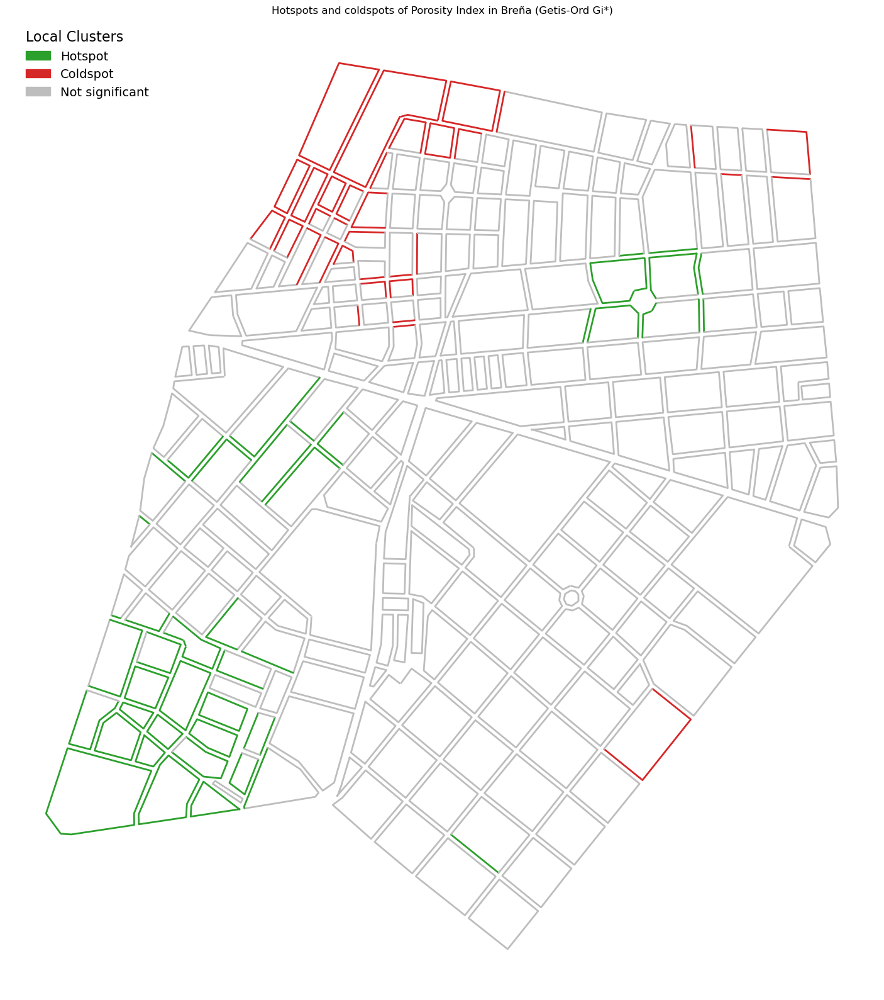

In [44]:
#Gettis Ord Gi*

gi = G_Local(y, w, star=True, permutations=PERMS)  
Z = gi.Zs                   # z-scores of Gi*
pvals = gi.p_sim            # simulated p-values

# Multiple comparison correction
if USE_FDR:
    _, pvals_adj, _, _ = multipletests(pvals, alpha=ALPHA, method="fdr_bh")
    sig_mask = pvals_adj < ALPHA
else:
    sig_mask = pvals < ALPHA

#Classification: hotspot/coldspot/no sig
labels_ok = np.where(sig_mask & (Z > 0), "Hotspot",
             np.where(sig_mask & (Z < 0), "Coldspot", "Not significant"))

#Diagnostic
print("\n=== Getis-Ord Gi* Diagnostic ===")
print(f"N observations: {len(y)} | α={ALPHA} | FDR={USE_FDR} | perms={PERMS}")
print("Z min/med/max:", np.min(Z), np.median(Z), np.max(Z))
print("pvals min/med/max:", np.min(pvals), np.median(pvals), np.max(pvals))
print("Label count:", pd.Series(labels_ok).value_counts(dropna=False))

#Assign to all edges
df_out = g.copy()
df_out["gi_label"] = pd.Series(index=df_out.index, dtype="object")
df_out.loc[g_ok.index, "gi_label"] = labels_ok

# Colors: green=hotspot (high), red=coldspot (low), gray=not significant
label_to_color = {
    "Hotspot": "#2ca02c",           # green
    "Coldspot": "#d62728",          # red
    "Not significant": "#bdbdbd",   # gray
}
df_out["gi_color"] = df_out["gi_label"].map(label_to_color).fillna("#bdbdbd")

#Plot
fig, ax = plt.subplots(figsize=(20, 16))
df_out.plot(color=df_out["gi_color"], linewidth=2, ax=ax)

legend_patches = [
    mpatches.Patch(color=label_to_color["Hotspot"], label="Hotspot"),
    mpatches.Patch(color=label_to_color["Coldspot"], label="Coldspot"),
    mpatches.Patch(color=label_to_color["Not significant"], label="Not significant"),
]
ax.legend(handles=legend_patches, title="Local Clusters",loc="upper left", bbox_to_anchor=(0.01, 1), frameon=False, fontsize=14, title_fontsize=16, alignment="left")
ax.set_axis_off()
ax.set_title(f"Hotspots and coldspots of Porosity Index in Breña (Getis-Ord Gi*)")
plt.tight_layout()
plt.show()

### Statistics per class

In [49]:
print("Number of streets per class:")
print(tab_edges)

print("\nTotal length of streets per class (in meters):")
print(tab_len)

# Calculate total number of streets
total_streets = tab_edges.sum()

# Calculate percentage of streets per class
percentages = (tab_edges / total_streets) * 100

# Print the percentages
print("\nPercentage of streets per class:")
print(percentages)

Number of streets per class:
porosity_label
High         309
Medium       291
Low          177
No data      102
Very High     92
Very Low      36
Name: count, dtype: int64

Total length of streets per class (in meters):
porosity_label
High         33471.969375
Medium       29625.155028
Low          16679.316575
Very High     8682.261541
No data       7018.560003
Very Low      3425.102362
Name: length, dtype: float64

Percentage of streets per class:
porosity_label
High         30.685204
Medium       28.897716
Low          17.576961
No data      10.129096
Very High     9.136048
Very Low      3.574975
Name: count, dtype: float64


In [53]:
# Calcular la mediana del índice de porosidad por cada clase
median_porosity_by_class = df_final.groupby('porosity_label')['median'].median()

# Imprimir los resultados
print("Mediana del índice de porosidad por clase:")
print(median_porosity_by_class)

Mediana del índice de porosidad por clase:
porosity_label
Very Low     0.053106
Low          0.184582
Medium       0.253961
High         0.317846
Very High    0.389633
No data           NaN
Name: median, dtype: float64


C:\Users\FIORELLA\AppData\Local\Temp\ipykernel_11864\2716397034.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  median_porosity_by_class = df_final.groupby('porosity_label')['median'].median()
